In [1]:
import matplotlib.pyplot as plt
import math
import numpy as np
import cmath
from numpy import *
from numpy.linalg import inv
from scipy.fftpack import fft, ifft, dct, idct
from scipy.io import wavfile
from IPython.display import Audio
from scipy.io.wavfile import write

In [4]:
fs, audio1 = wavfile.read('output.wav')
Audio('output.wav')

Audio Type: int16
Samples = 9353434   Channels = 2
Sampling frequency = 44100 Hz
Audio length: 212096 mili-seconds


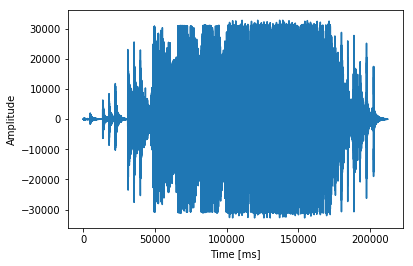

In [6]:
#Signal read from audio file
print(f"Audio Type: {audio1.dtype}")
print(f"Samples = {audio1.shape[0]}   Channels = {audio1.shape[1]}")
print(f"Sampling frequency = {fs} Hz")

audio = audio1.T[0]
samples = audio.shape[0]
L = (samples / fs)*1000
print(f'Audio length: {L:.0f} mili-seconds')

f, ax = plt.subplots()
ax.plot((np.arange(samples) / fs)*1000, audio)
ax.set_xlabel('Time [ms]')
ax.set_ylabel('Amplitude')
plt.show()

In [7]:
#Input sequence 
audio

array([ 0, -1,  0, ...,  8, 11,  8], dtype=int16)

In [8]:
#finding DCT of input sequence 
X_dct = dct(audio)
#DCT of sequence 
X_dct

array([-4.91078500e+07,  1.21316575e+07,  2.42032588e+07, ...,
       -3.23519996e+04, -2.56582584e+03, -1.00257443e+05])

9349434


Text(0,0.5,'Amplitude')

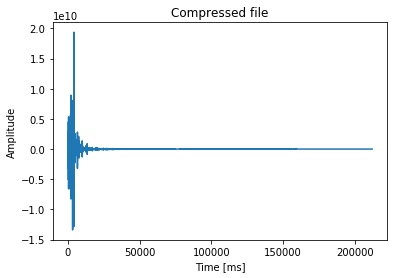

In [9]:
#Energy Compaction
M = 4000   #number of points to be set to 0 
N = len(audio)
#compact DCT sequence
X_m_dct = X_dct[:(N-M)]
print (len(X_m_dct))
plt.plot((np.arange(len(X_m_dct)) / fs)*1000, X_m_dct)
plt.title('Compressed file')
plt.xlabel('Time [ms]')
plt.ylabel('Amplitude')

In [10]:
#Storing the compact dct sequence in text file format along with value of N and M 
p = b = np.array([N, M]) 
filename = "dct_text.txt"
with open(filename,"w") as f:
    f.write("\n".join(" ".join(map(str, x)) for x in (X_m_dct,p)))
    f.close()
#file is saved with dct sequence and along with parameter N and M

In [11]:
#Reading the text file to get back dct seuence and parameter
filename = "dct_text.txt"
list_of_lists = []
with open(filename,"r") as f:
    for line in f:
        inner_list = [float(elt.strip()) for elt in line.split(' ')]
        list_of_lists.append(inner_list)
dct_m_retrived = list_of_lists[0]
N = int(list_of_lists[1][0])
M = int(list_of_lists[1][1])
print (len(dct_m_retrived))  #printing length of retrived dct
print (M,N) # the retured parameter
#file is saved with dct sequence and along with parameter N and M

9349434
4000 9353434


In [12]:
#Adding Zero Padding to retrived dct
for i in range(N-M,N):
    dct_m_retrived.append(0)
print(len(dct_m_retrived))

9353434


In [13]:
#finding the IDCT of retrived dct sequence
x_m = idct(dct_m_retrived)/(2*len(dct_m_retrived))

In [14]:
#printing the final obtained sequence
x_m

array([-3.95099958e-07, -9.99998815e-01, -1.97560503e-06, ...,
        8.00001471e+00,  1.09999912e+01,  8.00000294e+00])

In [15]:
#printing the original sequence
audio

array([ 0, -1,  0, ...,  8, 11,  8], dtype=int16)

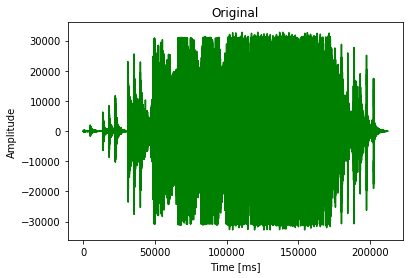

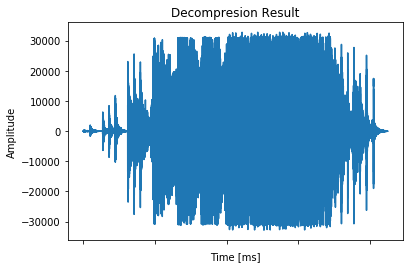

In [16]:
#ploting the final obtained sequence
plt.figure(1)
plt.plot((np.arange(samples) / fs)*1000, audio,'g')
plt.title('Original')
plt.xlabel('Time [ms]')
plt.ylabel('Amplitude')
plt.figure(2)
plt.plot((np.arange(samples) / fs)*1000, x_m)
plt.title('Decompresion Result')
plt.xlabel('Time [ms]')
plt.ylabel('Amplitude')
ax = plt.gca()
ax.set_xticklabels([])
plt.show()